In [46]:
%reload_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Number of batches of 32 images train_ds: 250
Number of batches of 32 images validation_ds: 32
Number of batches of 32 images test_ds: 32


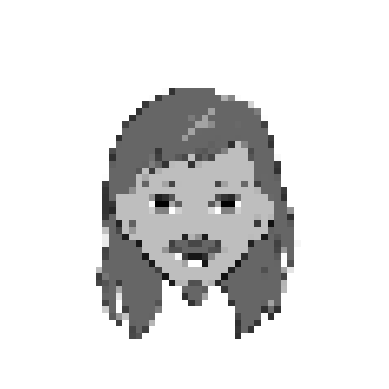

In [47]:
import generacion_cartoon.utils.paths as path
import notebooks.drac_CVAE_modified as CVAE
import tensorflow as tf
import imageio
import tensorflow_probability as tfp
%run "../generacion_cartoon/data/0.1-drac-make_dataset.ipynb"
import time
import numpy as np
import glob


In [48]:
print("GPUs disponibles:", len(tf.config.list_physical_devices('GPU')))

GPUs disponibles: 1


In [49]:
tf.config.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [50]:
def plot_latent_images(model, num_images_x, epoch, im_size=56, save=True, first_epoch=False, f_ep_count=0):
    
    # Create image matrix 
    image_width = im_size*num_images_x
    image_height = image_width
    image = np.zeros((image_height, image_width))

    # Create list of values which are evenly spaced wrt probability mass

    norm = tfp.distributions.Normal(0, 1)
    grid_x = norm.quantile(np.linspace(0.05, 0.95, num_images_x))
    grid_y = norm.quantile(np.linspace(0.05, 0.95, num_images_x))

    # For each point on the grid in the latent space, decode and
    # copy the image into the image array
    for i, yi in enumerate(grid_x):
        for j, xi in enumerate(grid_y):
            z = np.array([[xi, yi]])
            x_decoded = model.sample(z)
            digit = tf.reshape(x_decoded[0], (im_size, im_size))
            image[i * im_size: (i + 1) * im_size,
                  j * im_size: (j + 1) * im_size] = digit.numpy()
    

    # Plot the image array
    plt.figure(figsize=(10, 10))
    plt.imshow(image, cmap='Greys_r')
    plt.axis('Off')

    # Potentially save, with different formatting if within first epoch
    if save and first_epoch:
        name = 'tf_grid_at_epoch_{:04d}.{:04d}.png'.format(epoch, f_ep_count)
        plt.savefig(path.data_created_dir(name))
    elif save:
        name = 'tf_grid_at_epoch_{:04d}.png'.format(epoch)
        plt.savefig(path.data_created_dir(name))

In [51]:
import mlflow
import dagshub

In [52]:
params ={'latent_dim':2,'epochs':30, 'gamma':1.0, 'beta':2.0, 'epsilon':1e-4}
model = CVAE.CVAE(latent_dim=params['latent_dim'], gamma=params['gamma'], beta=params['beta'])

Initialized MLflow to track repo "DRACDARKTIME/VA_cartoon"

Repository DRACDARKTIME/VA_cartoon initialized!

Epoch: 1, Test set ELBO: -377.9016418457031, time elapse for current epoch: 14.348693370819092
Epoch: 2, Test set ELBO: -330.4538269042969, time elapse for current epoch: 7.88776159286499
Epoch: 3, Test set ELBO: -315.9166259765625, time elapse for current epoch: 7.687021732330322
Epoch: 4, Test set ELBO: -308.8418273925781, time elapse for current epoch: 7.6851983070373535
Epoch: 5, Test set ELBO: -303.14251708984375, time elapse for current epoch: 7.604015350341797
Epoch: 6, Test set ELBO: -300.1512451171875, time elapse for current epoch: 7.602522850036621
Epoch: 7, Test set ELBO: -298.2368469238281, time elapse for current epoch: 7.642147541046143
Epoch: 8, Test set ELBO: -296.5754089355469, time elapse for current epoch: 7.575309753417969
Epoch: 9, Test set ELBO: -295.37457275390625, time elapse for current epoch: 7.8981404304504395
Epoch: 10, Test set ELBO: -295.0917053222656, time elapse for current epoch: 7.620507717132568
Epoch: 11, Test set ELBO: -294.340576171875, time elaps

/tmp/ipykernel_216989/3165008714.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 10))


Epoch: 18, Test set ELBO: -289.1219177246094, time elapse for current epoch: 7.671892881393433
Epoch: 19, Test set ELBO: -288.8146667480469, time elapse for current epoch: 7.731161832809448
Epoch: 20, Test set ELBO: -288.32769775390625, time elapse for current epoch: 7.76092267036438
Epoch: 21, Test set ELBO: -287.6351318359375, time elapse for current epoch: 7.600679636001587
Epoch: 22, Test set ELBO: -287.5901794433594, time elapse for current epoch: 7.620384454727173
Epoch: 23, Test set ELBO: -287.0075988769531, time elapse for current epoch: 7.585232973098755
Epoch: 24, Test set ELBO: -286.1724853515625, time elapse for current epoch: 7.565234184265137
Epoch: 25, Test set ELBO: -285.635986328125, time elapse for current epoch: 7.6110687255859375
Epoch: 26, Test set ELBO: -285.5340881347656, time elapse for current epoch: 7.585622310638428
Epoch: 27, Test set ELBO: -284.7933349609375, time elapse for current epoch: 7.573654413223267
Epoch: 28, Test set ELBO: -284.099365234375, time 

2024/09/27 11:49:00 INFO mlflow.tracking._tracking_service.client: 🏃 View run casual-shrew-488 at: https://dagshub.com/DRACDARKTIME/VA_cartoon.mlflow/#/experiments/0/runs/53f4d54b7b1147b9b467a3431a9b59e3.
2024/09/27 11:49:00 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: https://dagshub.com/DRACDARKTIME/VA_cartoon.mlflow/#/experiments/0.


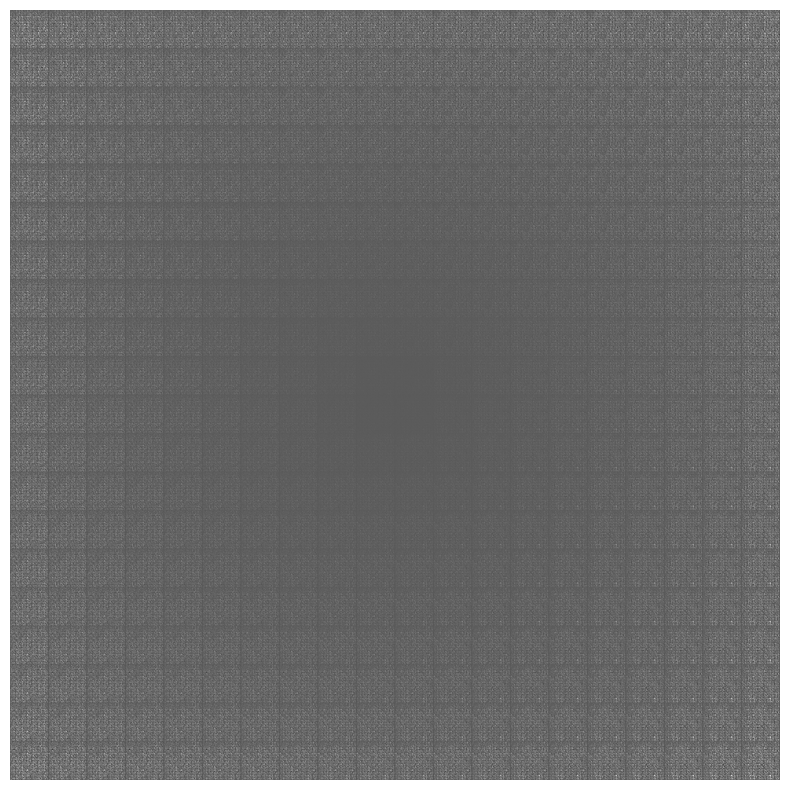

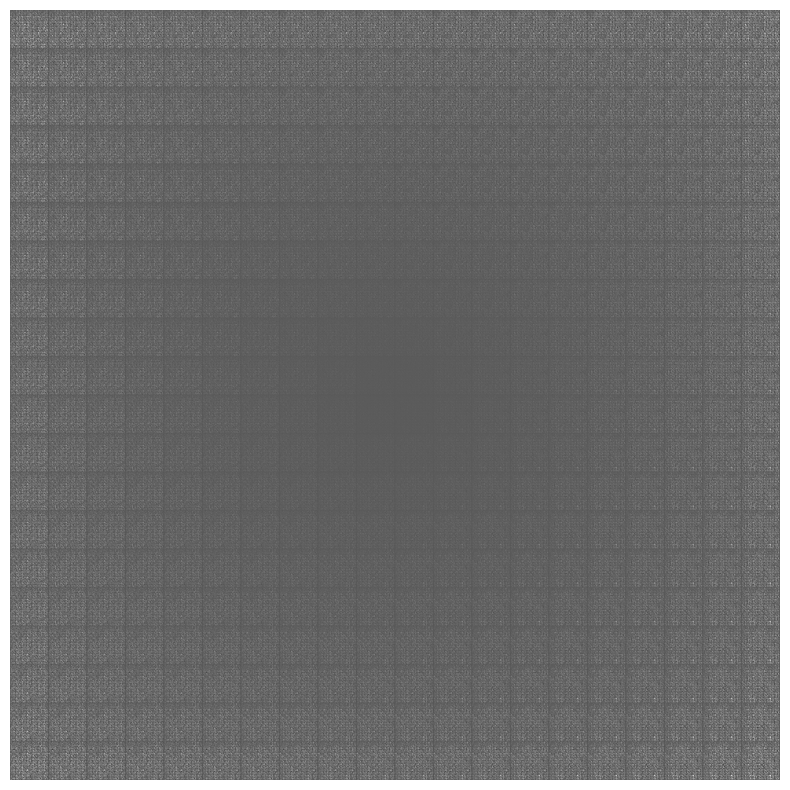

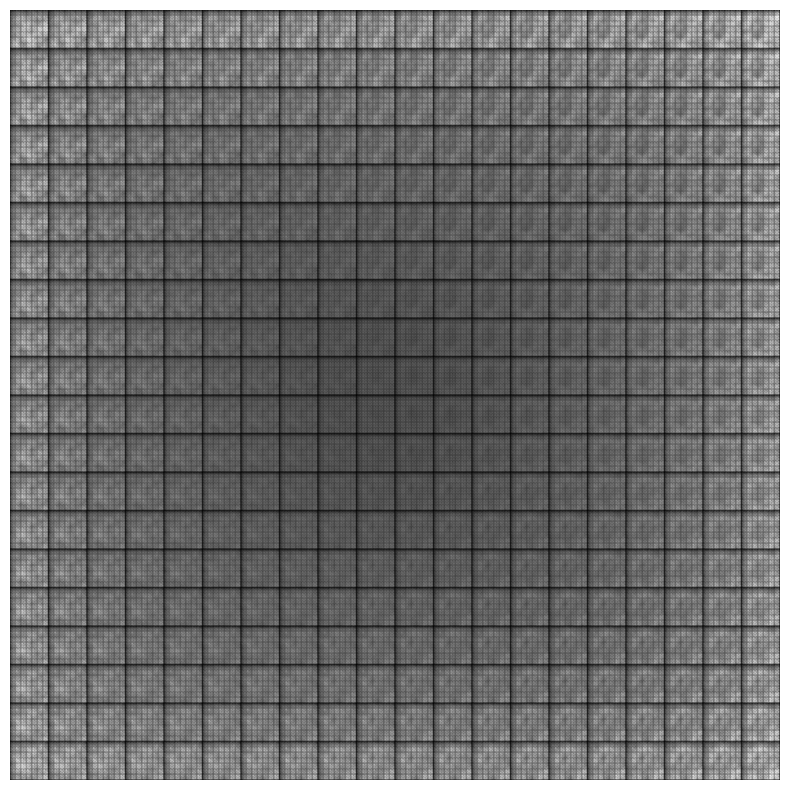

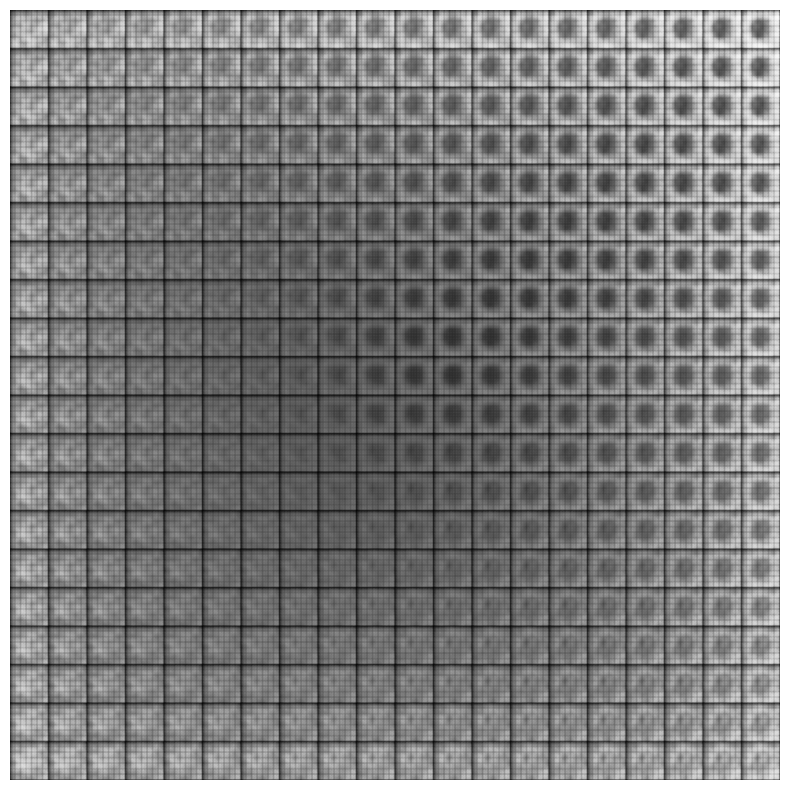

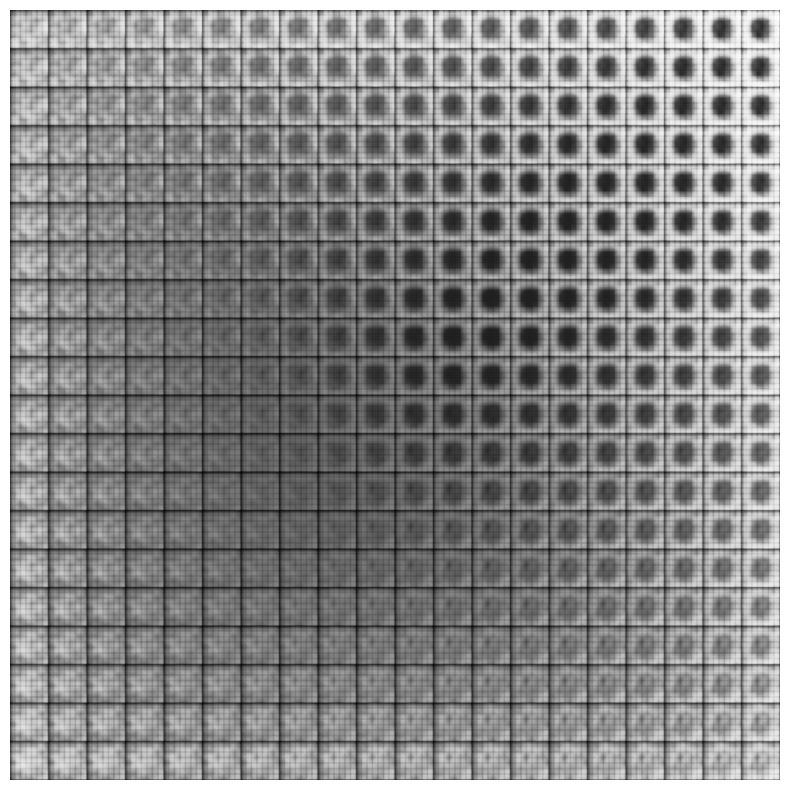

...

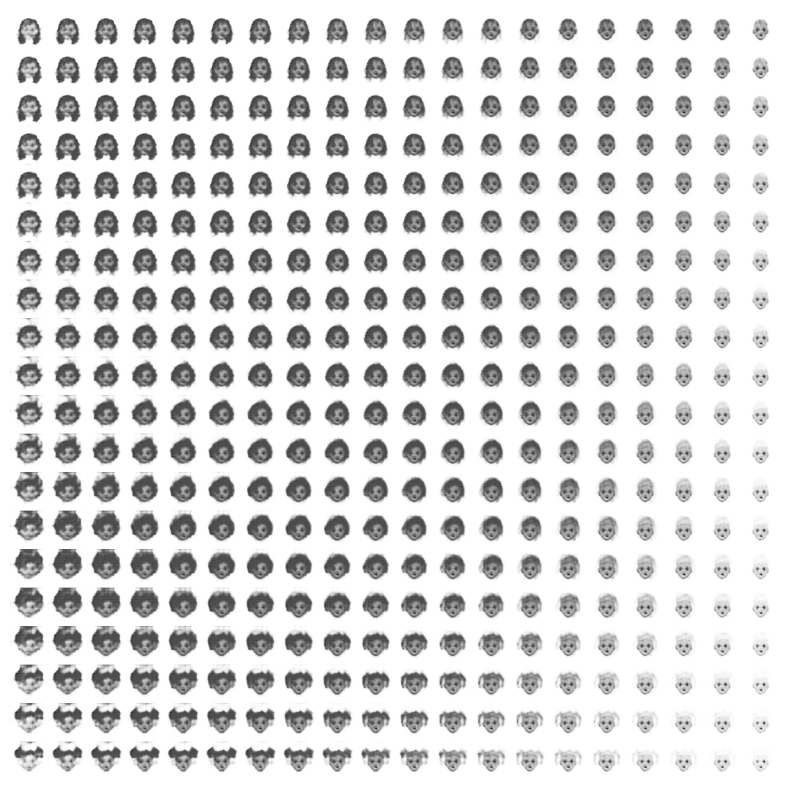

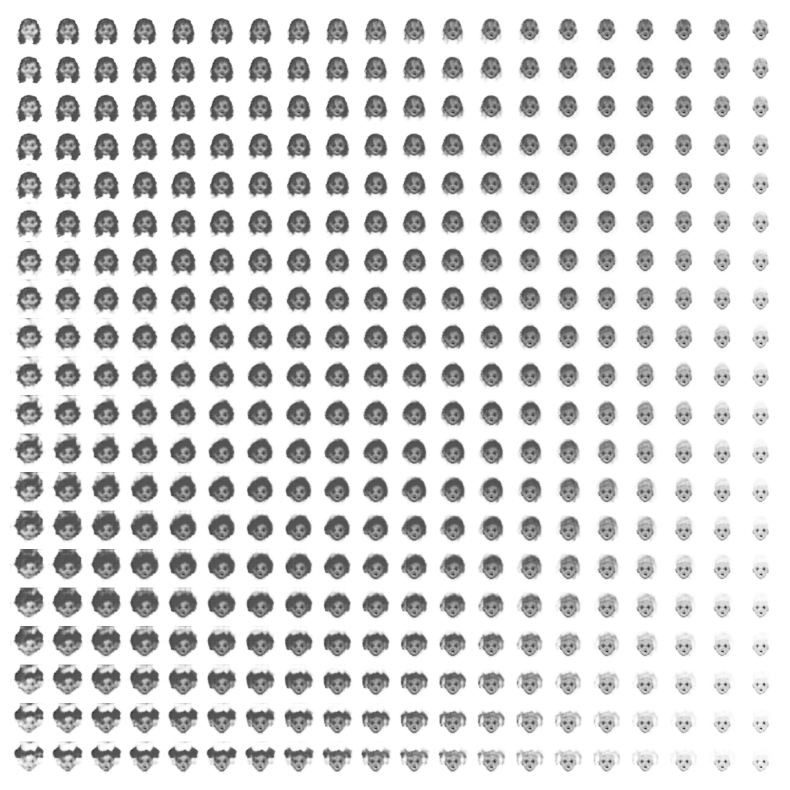

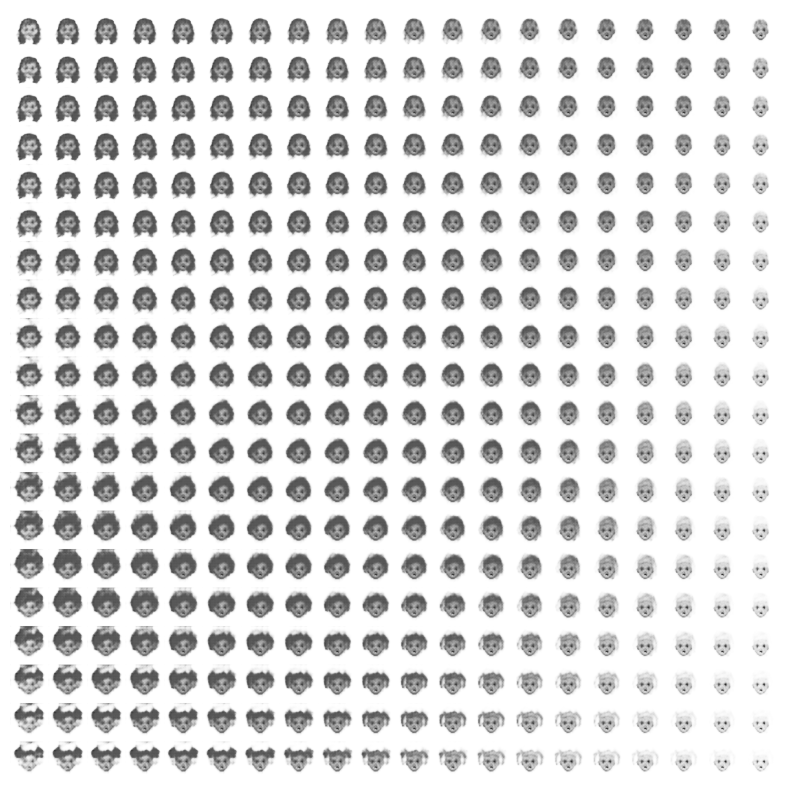

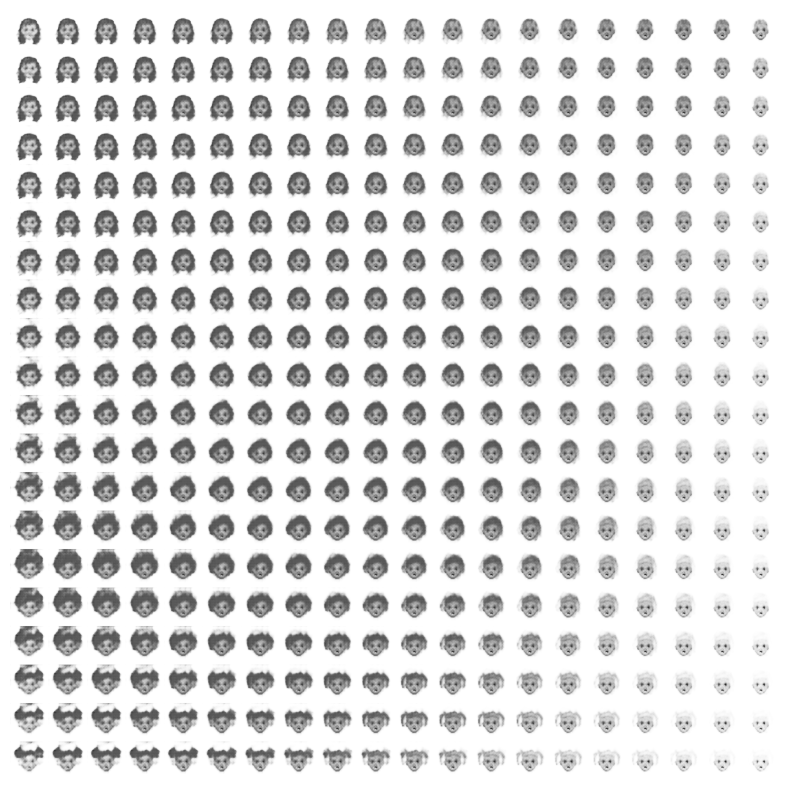

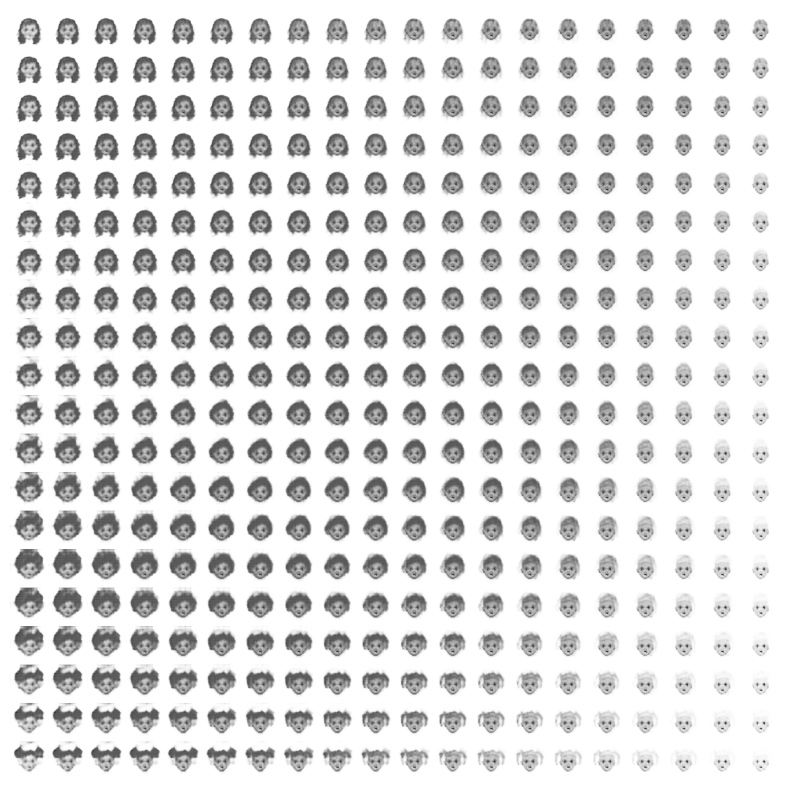

In [53]:
dagshub.init(repo_owner='DRACDARKTIME', repo_name='VA_cartoon', mlflow=True)
mlflow.set_experiment("LossFuntion_Modified_gamma_beta")
mlflow.start_run()
mlflow.log_params(params)

tf.config.run_functions_eagerly(True)
plot_latent_images(model=model, num_images_x=20, epoch=0)

optimizer = tf.keras.optimizers.Adam(params['epsilon'])

for epoch in range(1, params['epochs'] + 1):
    start_time = time.time()
    for idx, train_x in enumerate(train_ds):
        CVAE.train_step(model, train_x, optimizer)
        if epoch == 1 and idx % 75 == 0:
            plot_latent_images(model=model, num_images_x=20, epoch=epoch, first_epoch=True, f_ep_count=idx)          
    end_time = time.time()
    loss = tf.keras.metrics.Mean()
    for test_x in test_ds:
        loss(CVAE.compute_loss(model, test_x))
    elbo = -loss.result()
    mlflow.log_metric('elbo_loss_test', elbo, step = epoch)
    #display.clear_output(wait=False)
    print('Epoch: {}, Test set ELBO: {}, time elapse for current epoch: {}'
        .format(epoch, elbo, end_time - start_time))
    if epoch != 1:
        plot_latent_images(model=model, num_images_x= 20, epoch=epoch)
#mlflow.tensorflow.log_model(model, 'model')        
mlflow.end_run()

In [54]:
mlflow.end_run()

In [55]:
import os 

In [56]:
name_gif = f'grid_modified_gamma={params["gamma"]}_beta={params["beta"]}_epoch={params["epochs"]}.gif'
anim_file = path.data_created_dir(name_gif)
with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob(os.path.join(path.data_created_dir(),'tf_grid*.png'))
    filenames = sorted(filenames)
    for filename in filenames:
        #print(filename)
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)
for file in filenames:
    os.remove(file)

/tmp/ipykernel_216989/2787736416.py:8: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipykernel_216989/2787736416.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


In [57]:
name_model = f'model_modified_gamma={params["gamma"]}_beta={params["beta"]}_epochs={params["epochs"]}.weights.h5'
path_models = path.models_dir(name_model)

In [58]:
# Guardar los pesos del modelo
model.save_weights(path_models)


In [61]:
model.load_weights(path_models)

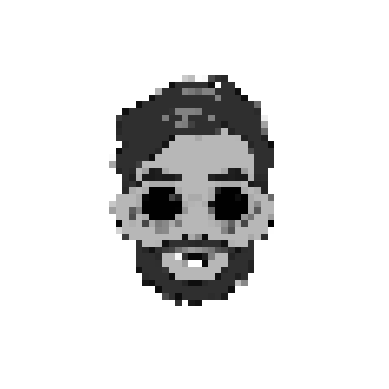

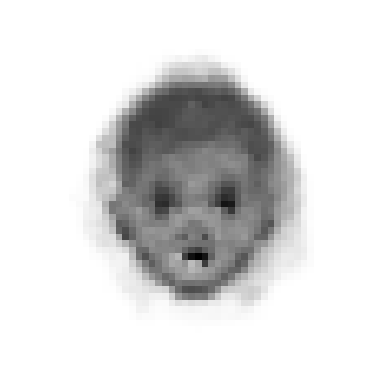

In [65]:
for img in test_ds:
    mean, logvar = model.encode(img)
    z = model.reparameterize(mean, logvar)
    generated_image = model.decode(z, apply_sigmoid=True)
    num_img = 10
    plt.imshow(img[num_img], cmap='gray')
    plt.axis('off')
    plt.show()

    plt.imshow(generated_image[num_img].numpy().squeeze(), cmap='gray')
    plt.axis('off')
    plt.show()
    break